# Вводная часть

Загружаем библиотеки

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
from scipy import stats
from matplotlib import pyplot as plt

Загружаем данные: 
  protein - база белков, в которых есть валин, с характеристиками: углы фи, пси, хи 1, альфа и другие.
  toy - данные стоимости игрушек, купленных людьми различных возрастов, полов и разных городор
  weight, height - вес и рост некоторой выборки людей
  language - форма речи некоторой выборки людей, разделенных по гендерному признаку





https://disk.yandex.ru/d/bOj13e6MqHb6xg

https://www.kaggle.com/code/carlolepelaars/statistics-tutorial/data

https://www.kaggle.com/datasets/burnoutminer/heights-and-weights-dataset?resource=download&select=SOCR-HeightWeight.csv

https://raw.githubusercontent.com/agricolamz/DS_for_DH/master/data/dialect_forms_fake.csv

In [ ]:
data = pd.read_csv('VAL_data.csv')
protein = data[["pbd_indx","phi", "psi", "tau", "chi_1", 'n_1_charge_pK','n_name_1', 'gamma1', 'gamma2']].copy()
cut_labels = ['1', '2', '3']
protein['kategory_chi_1'] = pd.qcut(protein['chi_1'].apply(np.cos),labels=False, q = [0. , 1/3, 2/3, 1], precision=0 )
toy = pd.read_csv('toy_dataset.csv')
data = pd.read_csv('SOCR-HeightWeight.csv')
weight = data['Weight(Pounds)']
height = data['Height(Inches)']

In [ ]:
weight

0        112.9925
1        136.4873
2        153.0269
3        142.3354
4        144.2971
           ...   
24995    118.0312
24996    120.1932
24997    118.2655
24998    132.2682
24999    124.8742
Name: Weight(Pounds), Length: 25000, dtype: float64

In [ ]:
height

0        65.78331
1        71.51521
2        69.39874
3        68.21660
4        67.78781
           ...   
24995    69.50215
24996    64.54826
24997    64.69855
24998    67.52918
24999    68.87761
Name: Height(Inches), Length: 25000, dtype: float64

In [ ]:
protein

,pbd_indx,phi,psi,tau,chi_1,n_1_charge_pK,n_name_1,gamma1,gamma2,kategory_chi_1
0,2BO5,-111.549986,-33.587430,101.756203,-73.912951,12.5,ARG,92.212055,89.999996,1.0
1,2BO5,-155.022155,130.097446,133.329796,-66.059859,0.0,PRO,89.999996,72.066501,0.0
2,2BO5,-110.169900,-24.967662,99.752700,-142.314804,4.2,GLU,9.838791,90.000003,1.0
3,2BO5,-52.790647,-29.272599,86.284812,-173.930435,0.0,GLY,155.249285,90.000003,1.0
4,2BO5,-63.061054,-88.793596,107.198463,-173.284369,0.0,TYR,90.000003,162.652158,0.0
...,...,...,...,...,...,...,...,...,...,...
10726,2YPM,-127.078680,115.231413,126.171000,165.914263,3.9,ASP,120.119258,90.000003,0.0
10727,2YPM,-67.626860,-15.398295,92.711533,-53.637080,3.9,ASP,90.000003,58.644018,0.0
10728,2YPM,-120.627026,74.440494,104.317371,-154.158079,4.2,GLU,90.000003,151.534044,0.0
10729,2YPM,-103.212632,-20.868799,99.613144,-54.941944,0.0,ALA,153.036645,90.000003,1.0


In [ ]:
toy

,Number,City,Gender,Age,Income,Illness
0,1,Dallas,Male,41,40367.0,No
1,2,Dallas,Male,54,45084.0,No
2,3,Dallas,Male,42,52483.0,No
3,4,Dallas,Male,40,40941.0,No
4,5,Dallas,Male,46,50289.0,No
...,...,...,...,...,...,...
149995,149996,Austin,Male,48,93669.0,No
149996,149997,Austin,Male,25,96748.0,No
149997,149998,Austin,Male,26,111885.0,No
149998,149999,Austin,Male,25,111878.0,No


# 1. Реализовать аппроксимацию распределений данных с помощью ядерных оценок.


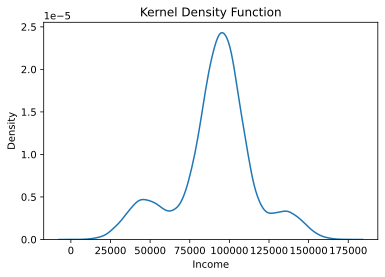

In [ ]:
def ex_1(df, column):
    sns.kdeplot(x=column, data=df, common_norm=False)
    plt.title("Kernel Density Function")
ex_1(toy, 'Income')

# 2. Реализовать анализ данных с помощью dotchart, boxplot и stripchart.

Analog cdplot in Python


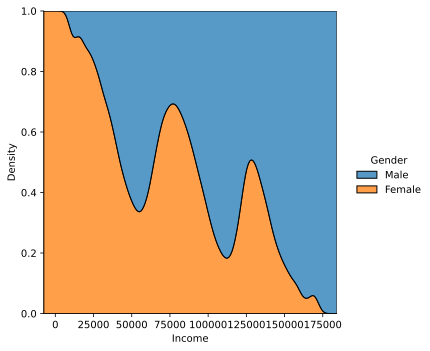

Boxplot


Analog dotchart in Python


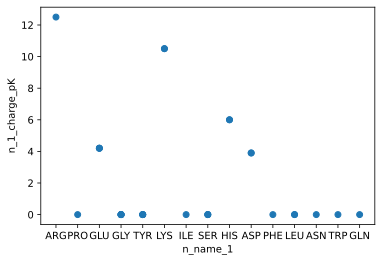

Analog stripchart in Python


In [ ]:
def ex_2(df_1, column_1_1, column_1_2, column_1_3, df_2, column_2_1, column_2_2):
    print("Analog cdplot in Python")

    sns.displot(data = df_1, x = column_1_2, hue = column_1_1, multiple="fill", kind="kde")
    plt.show()
    print("Boxplot")
    plt.xlabel(column_1_1)
    plt.ylabel(column_1_2)
    sns.boxplot(data=df_1, x=column_1_1, y=column_1_2)
    plt.show()
    
    print("Analog dotchart in Python")
    
    plt.xlabel(column_2_1)
    plt.ylabel(column_2_2)
    plt.scatter(df_2[0:30][column_2_1], df_2[0:30][column_2_2])
    plt.show()
    
    print("Analog stripchart in Python")
    sns.set(rc={"figure.figsize": (18,10)})
    sns.stripplot(data=toy, x=column_1_3, y=column_1_2)
    plt.show()
    
ex_2(toy, 'Gender', 'Income', 'City', protein, 'n_name_1', 'n_1_charge_pK')

# 3. Проверить, являются ли наблюдения выбросами с точки зрения формальных статистических критериев Граббса и Q-теста Диксона. Визуализировать результаты.

Q-теста Диксона для выборки размером не большей длины 26, выдающих результат являются ли максимальный и минимальный элемент выборки выбросами

In [ ]:
def dixon_test(data, left=True, right=True):
    
    """
    Keyword arguments:
        data = A ordered or unordered list of data points (int or float).
        left = Q-test of minimum value in the ordered list if True.
        right = Q-test of maximum value in the ordered list if True.
        q_dict = A dictionary of Q-values for a given confidence level,
            where the dict. keys are sample sizes N, and the associated values
            are the corresponding critical Q values. E.g.,
            {3: 0.97, 4: 0.829, 5: 0.71, 6: 0.625, ...}

    Returns a list of 2 values for the outliers, or None.
    E.g.,
       for [1,1,1] -> [None, None]
       for [5,1,1] -> [None, 5]
       for [5,1,5] -> [1, None]

    """
    q_dict = [0.97, 0.829, 0.71, 0.625, 0.568, 0.526, 0.493, 0.466,
       0.444, 0.426, 0.41, 0.396, 0.384, 0.374, 0.365, 0.356,
       0.349, 0.342, 0.337, 0.331, 0.326, 0.321, 0.317, 0.312,
       0.308, 0.305, 0.301, 0.29]#из таблицы
    sdata = sorted(data)
    Q_mindiff, Q_maxdiff = (0,0), (0,0)

    if left:
        Q_min = (sdata[1] - sdata[0])
        try:
            Q_min /= (sdata[-1] - sdata[0])
        except ZeroDivisionError:
            pass
        Q_mindiff = (Q_min - q_dict[len(data)], sdata[0])

    if right:
        Q_max = abs((sdata[-2] - sdata[-1]))
        try:
            Q_max /= abs((sdata[0] - sdata[-1]))
        except ZeroDivisionError:
            pass
        Q_maxdiff = (Q_max - q_dict[len(data)], sdata[-1])

    if not Q_mindiff[0] > 0 and not Q_maxdiff[0] > 0:
        outliers = [None, None]

    elif Q_mindiff[0] == Q_maxdiff[0]:
        outliers = [Q_mindiff[1], Q_maxdiff[1]]

    elif Q_mindiff[0] > Q_maxdiff[0]:
        outliers = [Q_mindiff[1], None]

    else:
        outliers = [None, Q_maxdiff[1]]

    return outliers

критерий Граббса

In [ ]:
def grubbs(sample):
        """
        функция находит значение критерия Граббса и максимальное значение в наборе данных, 
        потом — критическое значение с учётом объёма выборки и уровня значимости,
        а в конце проверяет, является ли значение с максимальным индексом выбросом
        """
        size = len(sample)
        alpha = 0.05
        t_dist = stats.t.ppf(1 - alpha / (2 * size), size - 2)
        numerator = (size - 1) * np.sqrt(np.square(t_dist))
        denominator = np.sqrt(size) * np.sqrt(size - 2 + np.square(t_dist))
        critical_value = numerator / denominator
        print("\tGrubbs Critical Value: %.3f" %(critical_value))
        
        std_dev = np.std(sample)
        avg = np.mean(sample)
        abs_val_minus_avg = abs(sample - avg)
        max_of_deviations = max(abs_val_minus_avg)
        max_index = np.argmax(abs_val_minus_avg)
        gsv = max_of_deviations / std_dev
        print("\tGrubbs Statistics Value: %.3f" %(gsv))
        
        if gsv > critical_value:
            print(f"\t{sample[max_index]} is an outlier")
        else:
            print(f"\t{sample[max_index]} is not an outlier")

In [ ]:
def ex_3(sample, change_value):
    print("Визуализация")
    sns.set(rc={"figure.figsize": (18,10)})
    sns.boxplot(data=sample)
    plt.show()
    sample_change = sample.copy()
    sample_change[0] = change_value
    print("Визуализация с добавлением выброса")
    sns.set(rc={"figure.figsize": (18,10)})
    sns.boxplot(data=sample_change)
    plt.show()
    print("Критерий Граббса:")
    grubbs(sample)
    print("Критерий Граббса для измененной выборки:")
    grubbs(sample_change)
    print( "Q-теста Диксона(правый и левый выброс): {0}".format(dixon_test(sample)))
    dixon_test(sample)
    print( "Q-теста Диксона(правый и левый выброс) для измененной выборки: {0}".format(dixon_test(sample_change)))
    dixon_test(sample_change)

Функция проверяет на наличие выбросов в исходной выборке и с замещением нулевого элемента на желаемое значение

Визуализация


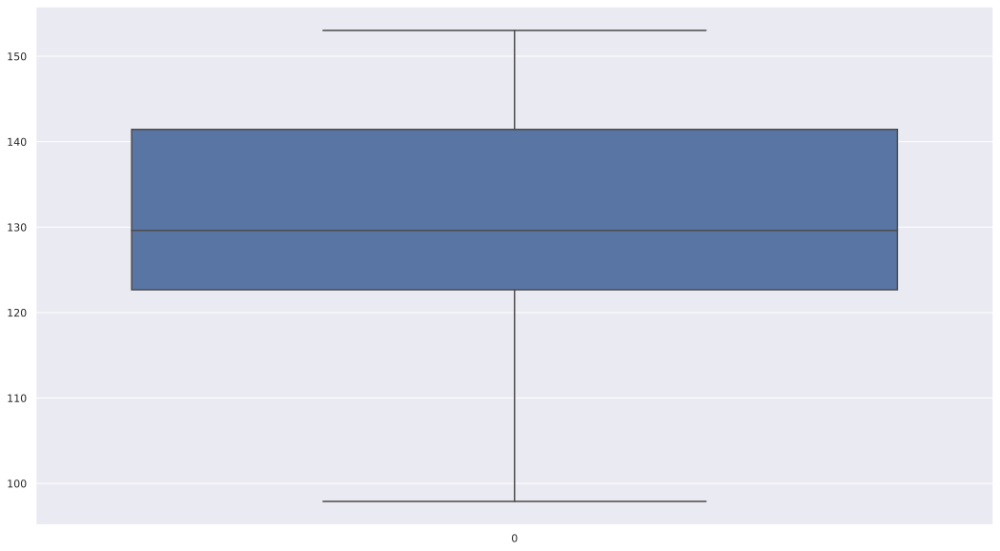

Визуализация с добавлением выброса


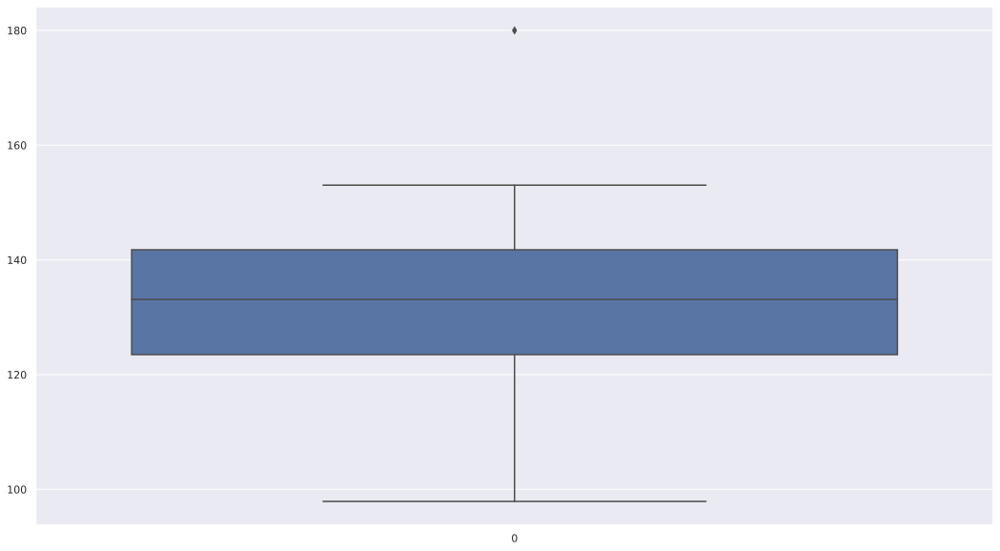

Критерий Граббса:
	Grubbs Critical Value: 2.841
	Grubbs Statistics Value: 2.545
	97.90191 is not an outlier
Критерий Граббса для измененной выборки:
	Grubbs Critical Value: 2.841
	Grubbs Statistics Value: 3.051
	180.0 is an outlier
Q-теста Диксона(правый и левый выброс): [None, None]
Q-теста Диксона(правый и левый выброс) для измененной выборки: [None, 180.0]


In [ ]:
ex_3(weight[0:26], 180)

Визуализация


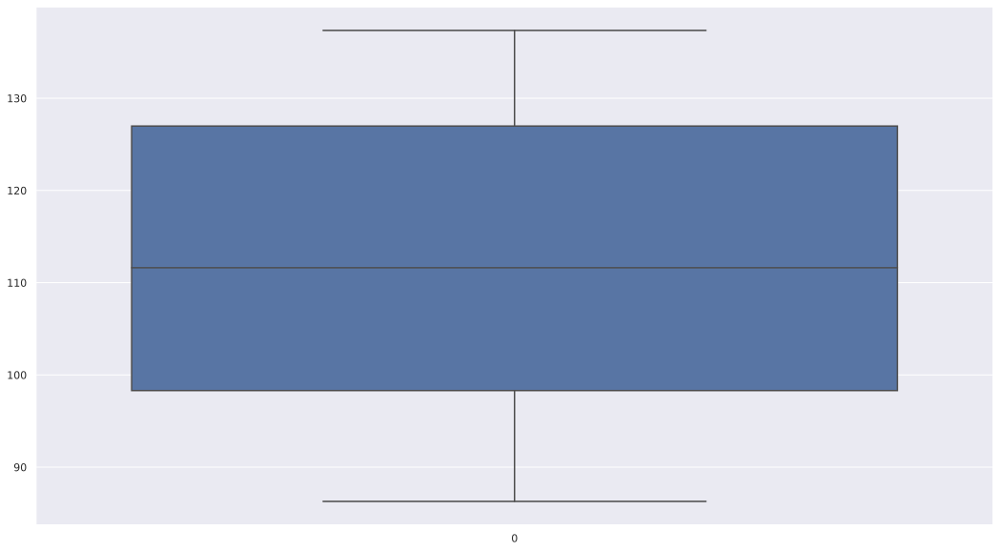

Визуализация с добавлением выброса


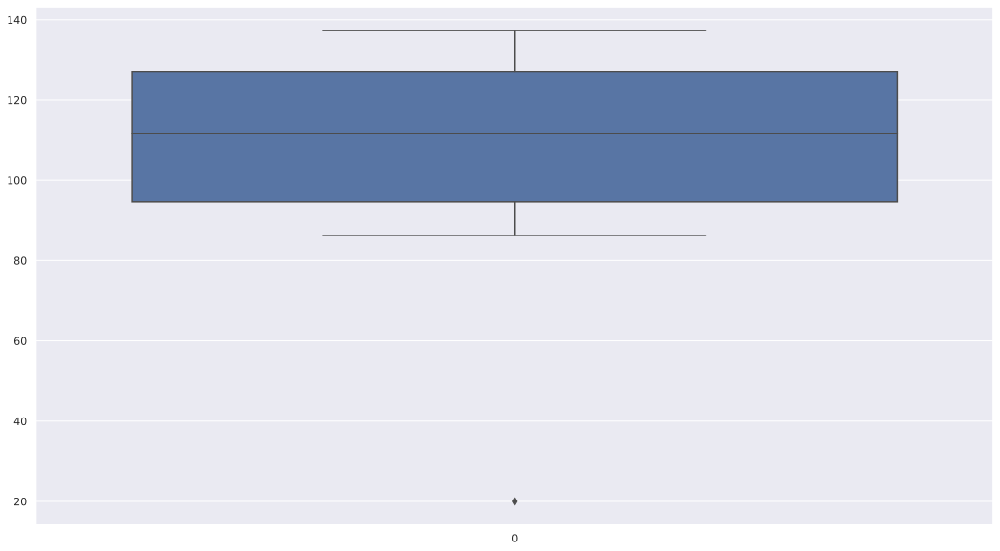

Критерий Граббса:
	Grubbs Critical Value: 2.841
	Grubbs Statistics Value: 1.558
	137.35365826586656 is not an outlier
Критерий Граббса для измененной выборки:
	Grubbs Critical Value: 2.841
	Grubbs Statistics Value: 3.664
	20.0 is an outlier
Q-теста Диксона(правый и левый выброс): [None, None]
Q-теста Диксона(правый и левый выброс) для измененной выборки: [20.0, None]


In [ ]:
ex_3(protein['tau'][0:26], 20)

# 4. Воспользовались инструментами для заполнения пропусков в данных. Пропуски внести вручную и сравнить результаты заполнения с истинными значениями.

In [ ]:
sample = protein[["chi_1"]].copy()
def ex_4(sample):
    cnt_nan = sample.isnull().sum()
    print(sample)
    print("Количество пропусков:\n{0}\n".format(cnt_nan))
    print("Добавили пропуски:\n")
    pd.options.mode.chained_assignment = None
    sample.loc[sample['chi_1'] > 0, 'chi_1'] = np.nan
    print(sample)
    mean = sample.mean()
    sample = sample.fillna(mean)
    cnt_nan = sample.isnull().sum()
    print("Заменено на:\n{0}".format(mean))
    print("Результат")
    print(sample)
ex_4(sample[120:130])

          chi_1
120  174.599245
121         NaN
122  165.083751
123  176.574843
124   79.521250
125  -67.283522
126  -63.764013
127 -157.288526
128  179.980591
129 -178.496589
Количество пропусков:
chi_1    1
dtype: int64

Добавили пропуски:

          chi_1
120         NaN
121         NaN
122         NaN
123         NaN
124         NaN
125  -67.283522
126  -63.764013
127 -157.288526
128         NaN
129 -178.496589
Заменено на:
chi_1   -116.708162
dtype: float64
Результат
          chi_1
120 -116.708162
121 -116.708162
122 -116.708162
123 -116.708162
124 -116.708162
125  -67.283522
126  -63.764013
127 -157.288526
128 -116.708162
129 -178.496589


# 5. Сгенерировать данные из нормального распределения с различными параметрами и провести анализ с помощью графиков эмпирических функций распределений, квантилей, метода огибающих, а также стандартных процедур проверки гипотез о нормальности (критерии Колмогорова-Смирнова, Шапиро- Уилка, Андерсона-Дарлинга, Крамера фон Мизеса, Колмогорова-Смирнова в модификации Лиллиефорса и Шапиро-Франсия). Рассмотреть выборки малого (не более 50-100 элементов) и умеренного (1000-5000 наблюдений) объемов.

In [ ]:
from statsmodels.distributions.empirical_distribution import ECDF
from statsmodels.stats.diagnostic import lilliefors

In [ ]:
def creat_normal_distribution(mean, var, size):
    return pd.Series(stats.norm.rvs(loc=mean, scale=var, size=size))
def normal_distribution_plot(mean, var, size):
    xs = pd.Series(stats.norm.rvs(loc=mean, scale=var, size=size))
    xs.hist(bins=20)
    plt.xlabel('Нормальное распределение')
    plt.ylabel('Частота')
    plt.show()
    return xs
def quantile_plot(xs):
    d = {0:sorted(stats.norm.rvs(loc=0, scale=1, size=len(xs))),
         1:sorted(xs)}
    pd.DataFrame(d).plot.scatter(0, 1, s=5, grid=True)
    plt.xlabel('Квантили теоретического нормального распределения')
    plt.ylabel('Квантили данных')
    plt.title ('Квантильный график', fontweight='semibold')
    plt.show()
    
def empiric_plot(xs):
    ecdf = ECDF(xs)
    plt.plot(ecdf.x, ecdf.y)
    plt.ylabel('$f(x)$')
    plt.xlabel('$x$')
    plt.title ('Эмпирическая функция распределения')
    plt.show()
def ex_5(mean, var, size):
    print("Нормальное распределение с матожиданием {0} и дисперсией {1} и объёма {2}. ".format(mean, var, size))
    xs = normal_distribution_plot(mean, var, size)
    quantile_plot(xs)
    empiric_plot(xs)
    print('Критерий Колмогорова-Смирнова:\n\t', stats.kstest(xs, 'norm'))
    print('Тест Шапира-Уилка:\n\t', stats.shapiro(xs))
    print('Тест Андерсона-Дарлинга:\n\t', stats.anderson(xs))
    print('Тест Крамера фон Мизеса:\n\t', stats.cramervonmises(xs, 'norm')) 
    print('Тест Лиллиефорса:\n\t' ,  lilliefors(xs, 'norm'))

Функция принимает желамые среднее, дисперсию и количество событий для нормального распределения

Нормальное распределение с матожиданием 0 и дисперсией 1 и объёма 100. 


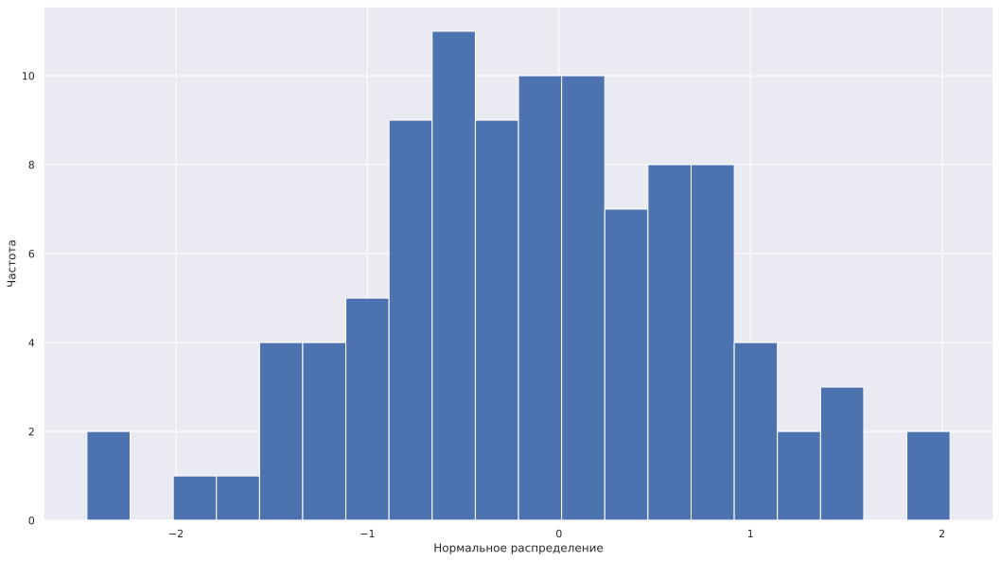

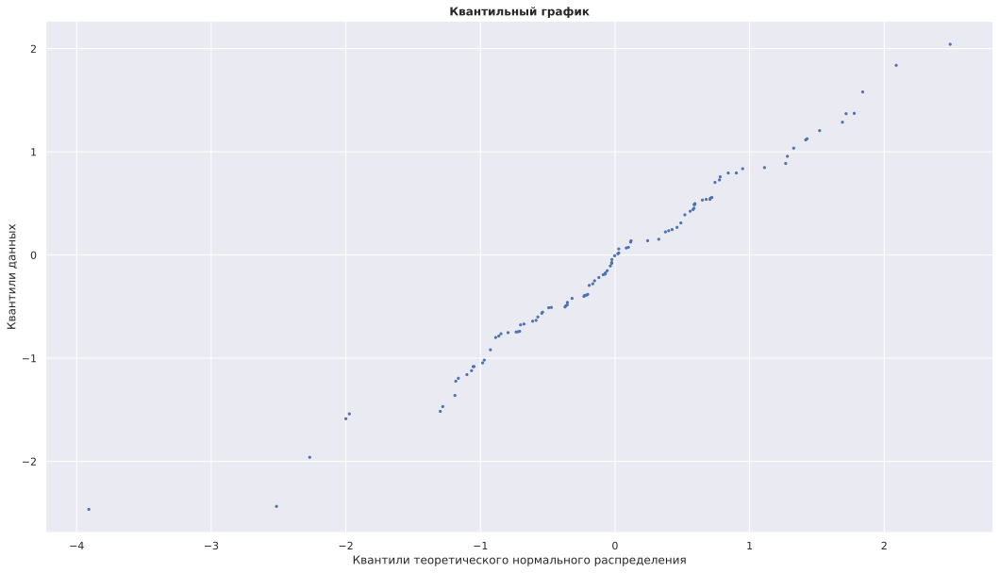

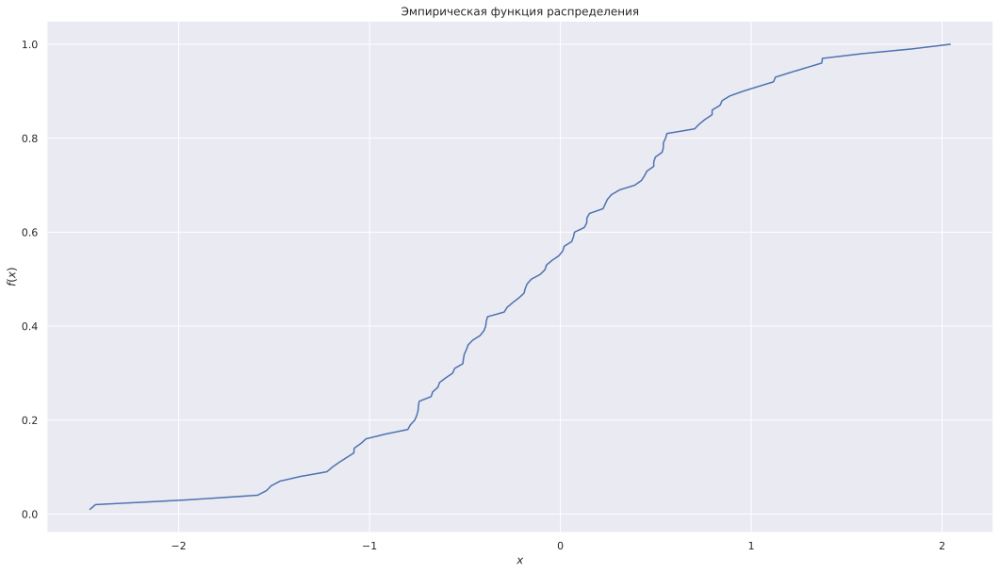

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.09833345823520023, pvalue=0.2701837325087038)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.99459308385849, pvalue=0.9632021188735962)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.1319526000456932, critical_values=array([0.555, 0.632, 0.759, 0.885, 1.053]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=0.2144312099186031, pvalue=0.2413412173013859)
Тест Лиллиефорса:
	 (0.0473727703266322, 0.8408671613461722)
Нормальное распределение с матожиданием 0 и дисперсией 1 и объёма 1000. 


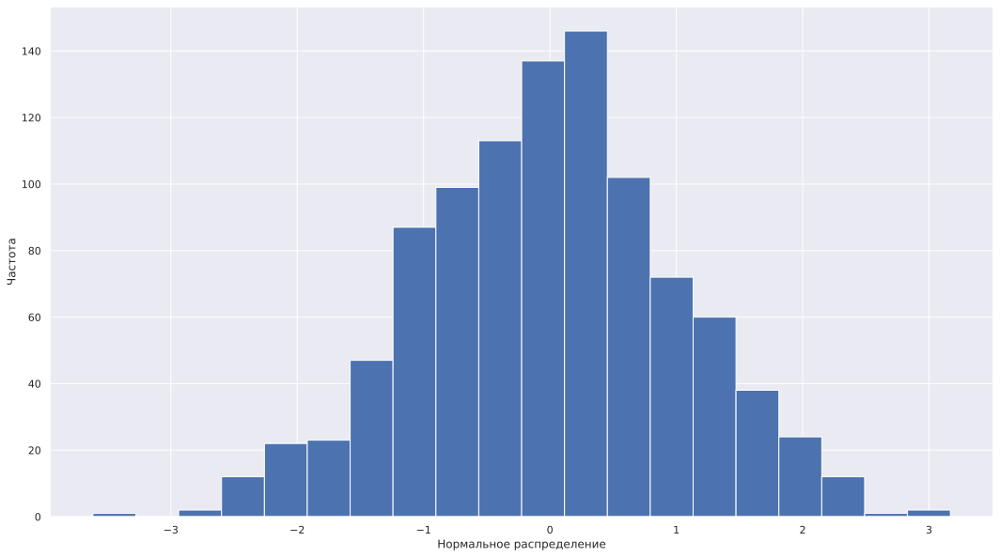

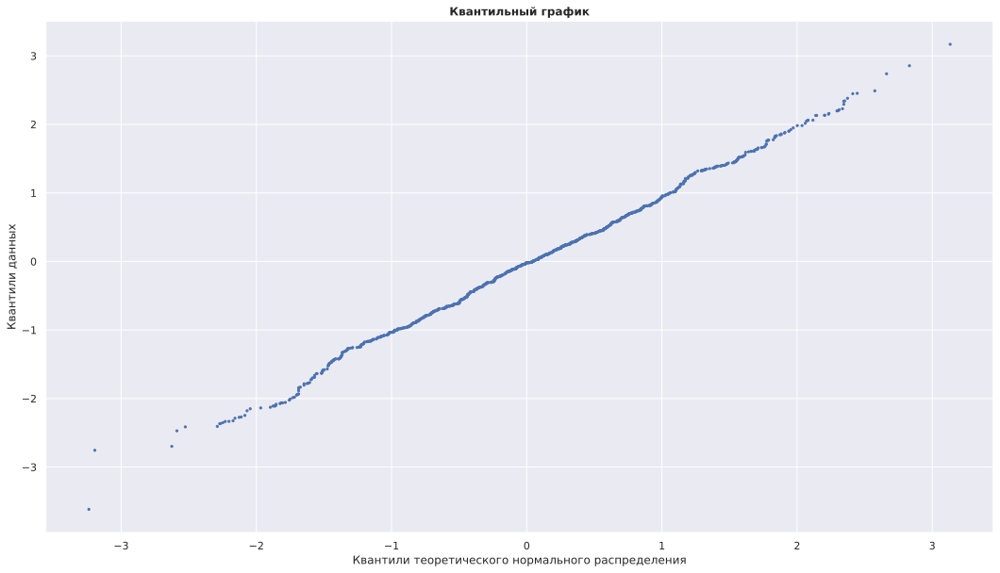

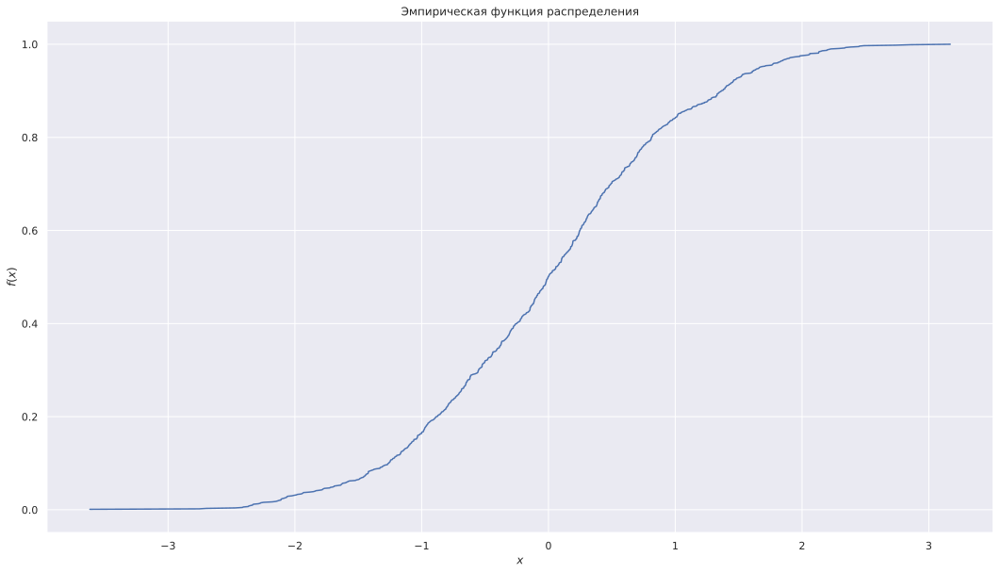

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.020790278900059134, pvalue=0.7722032848522019)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9985581040382385, pvalue=0.5929641723632812)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.3435310701756862, critical_values=array([0.574, 0.653, 0.784, 0.914, 1.088]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=0.05439922966029747, pvalue=0.8492687190749145)
Тест Лиллиефорса:
	 (0.018663048804243743, 0.6217245454240834)
Нормальное распределение с матожиданием 0 и дисперсией 1 и объёма 5000. 


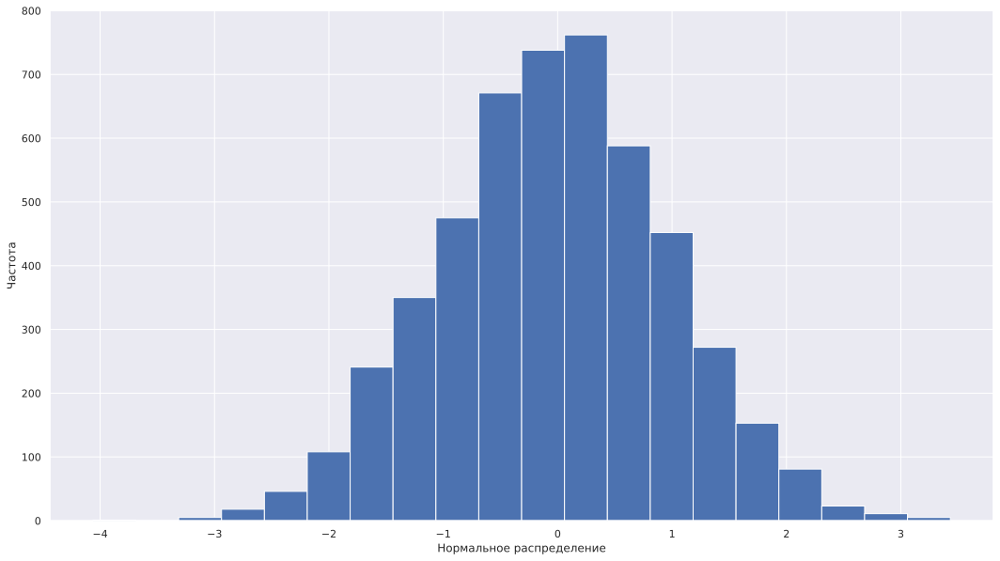

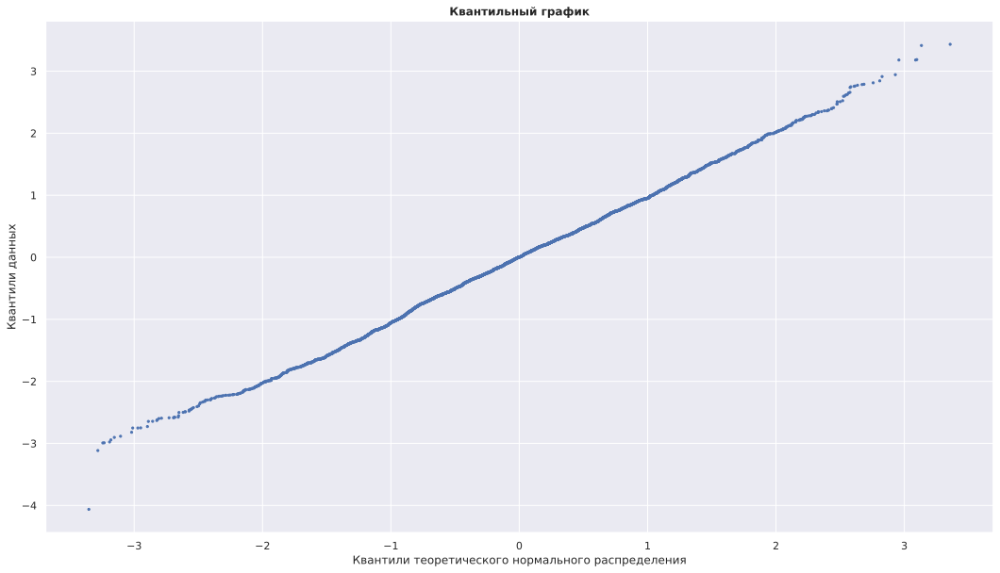

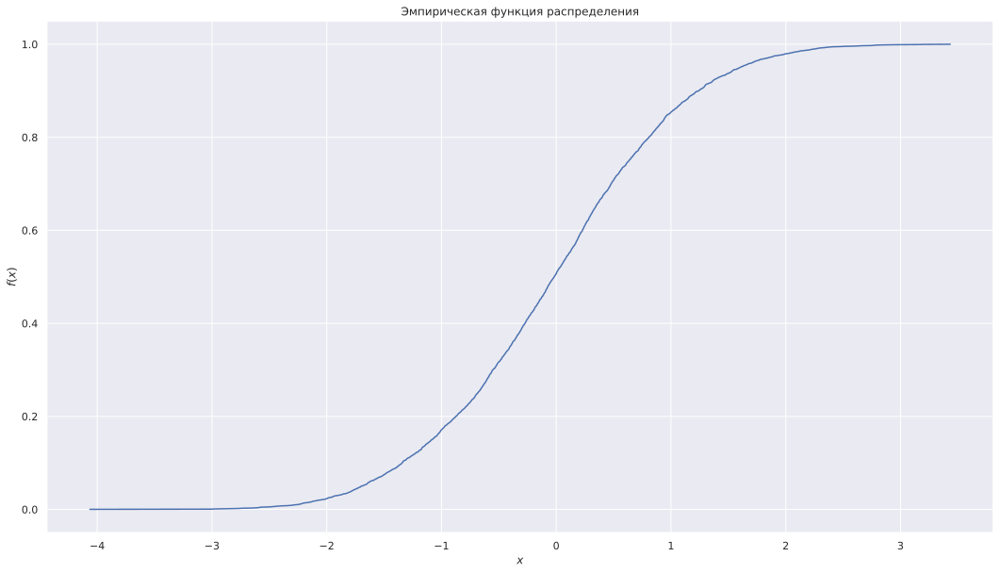

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.01784159310352673, pvalue=0.0819107673134426)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9995710253715515, pvalue=0.3465700149536133)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.5344330361785978, critical_values=array([0.576, 0.655, 0.786, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=0.4368742918942131, pvalue=0.057840479692713664)
Тест Лиллиефорса:
	 (0.009046594644467665, 0.4230850684582524)
Нормальное распределение с матожиданием 5 и дисперсией 4 и объёма 100. 


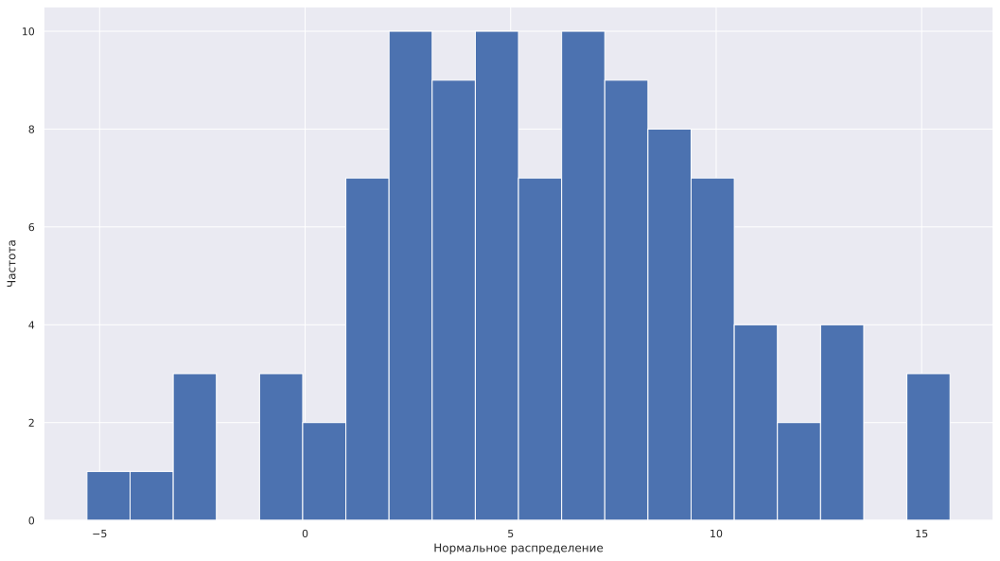

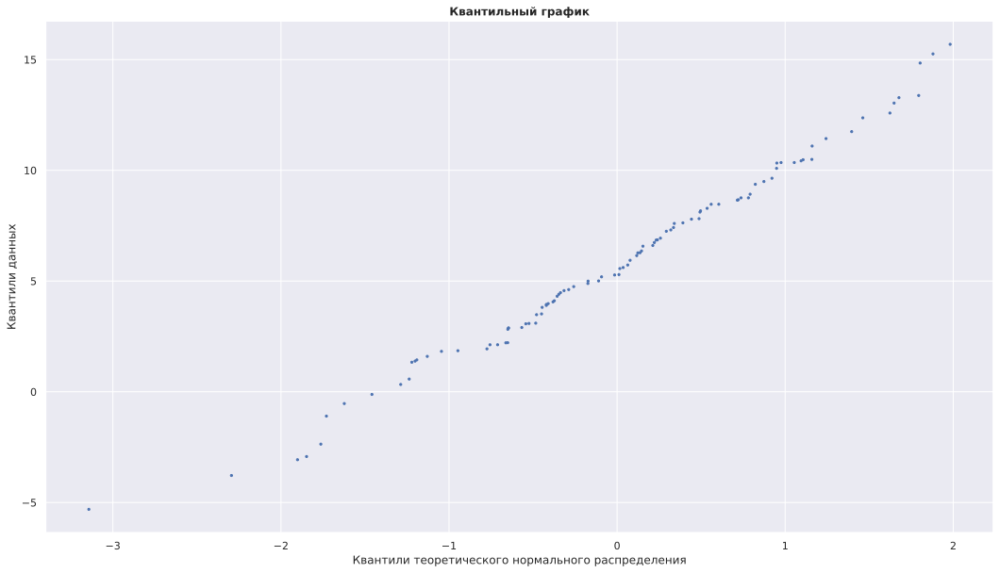

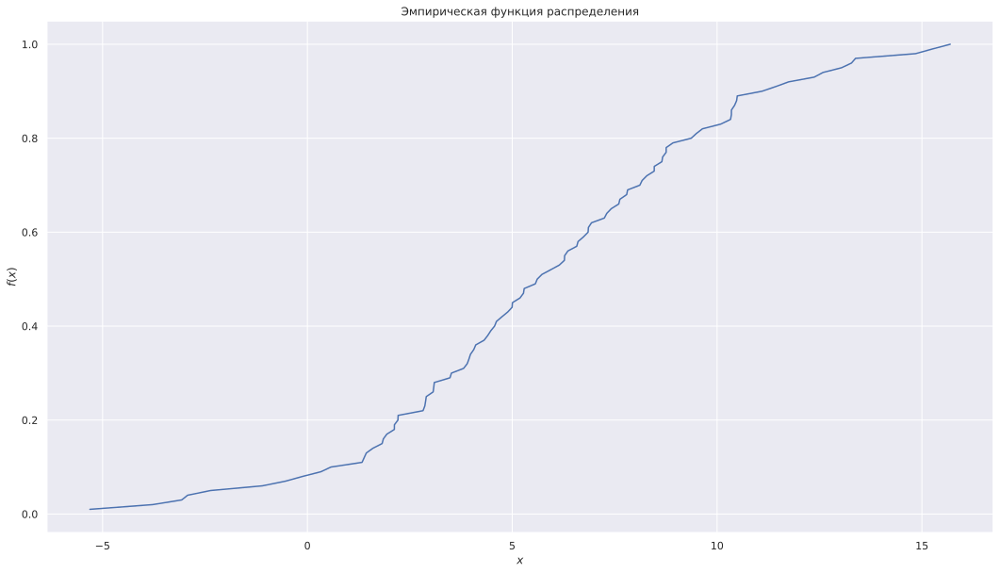

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.825926259641784, pvalue=7.85647060026734e-76)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9939363598823547, pvalue=0.9375877380371094)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.1437255830292088, critical_values=array([0.555, 0.632, 0.759, 0.885, 1.053]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=24.40882161632686, pvalue=2.013665456601643e-09)
Тест Лиллиефорса:
	 (0.04574650006518663, 0.878308114422579)
Нормальное распределение с матожиданием 5 и дисперсией 4 и объёма 1000. 


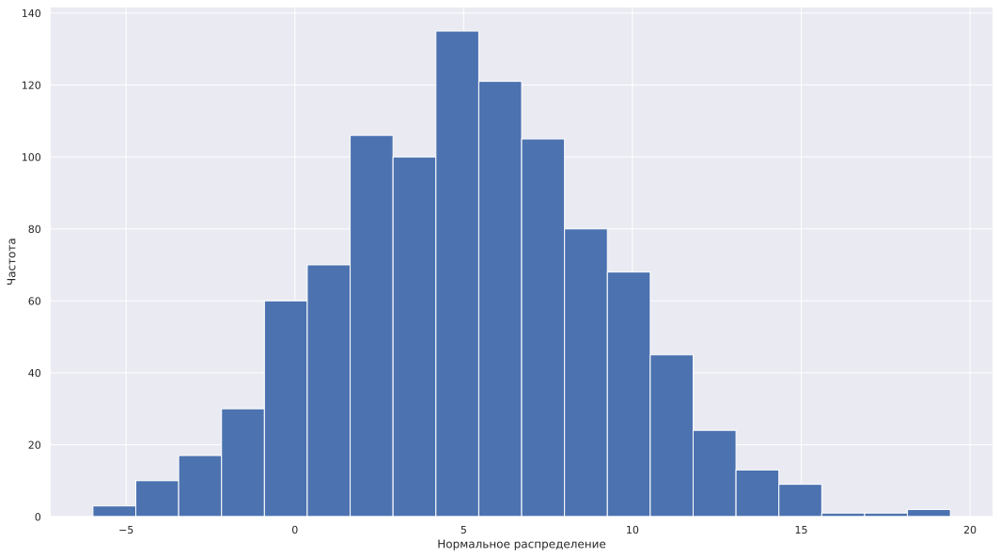

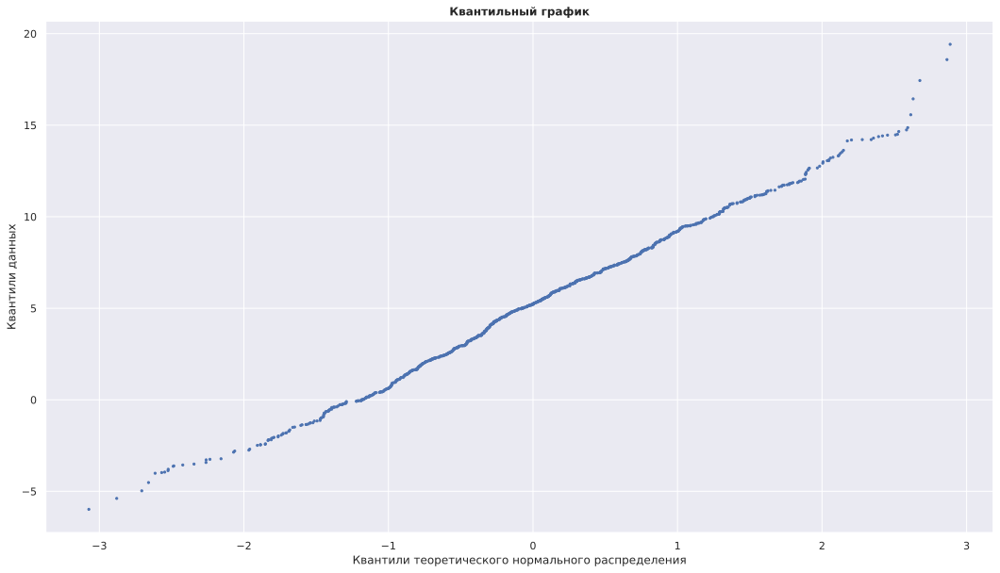

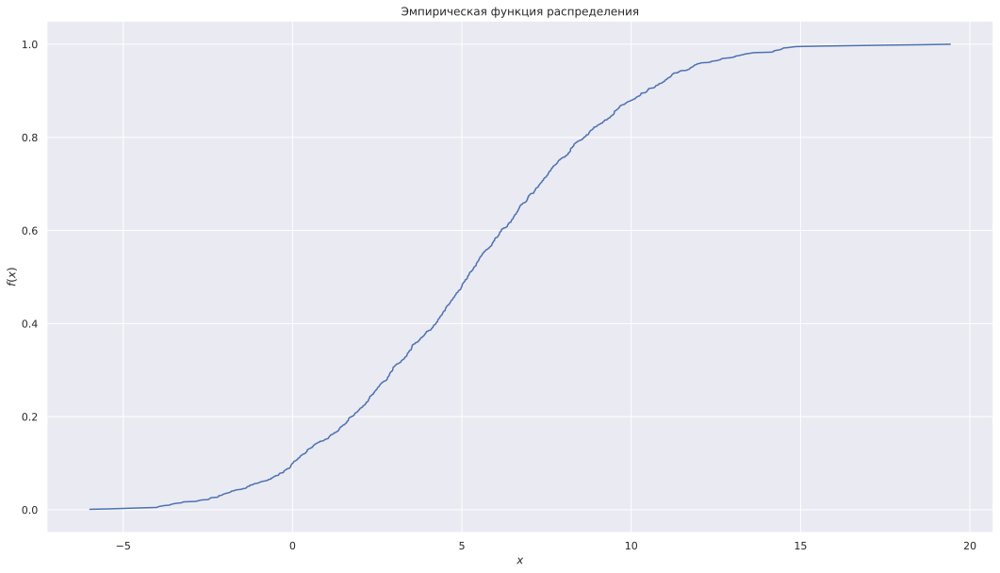

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.7630776088267692, pvalue=0.0)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9982287883758545, pvalue=0.3919749855995178)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.24628010312119386, critical_values=array([0.574, 0.653, 0.784, 0.914, 1.088]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=214.37691212310563, pvalue=5.410736225730517e-08)
Тест Лиллиефорса:
	 (0.017900751416543736, 0.6875376493561346)
Нормальное распределение с матожиданием 5 и дисперсией 4 и объёма 5000. 


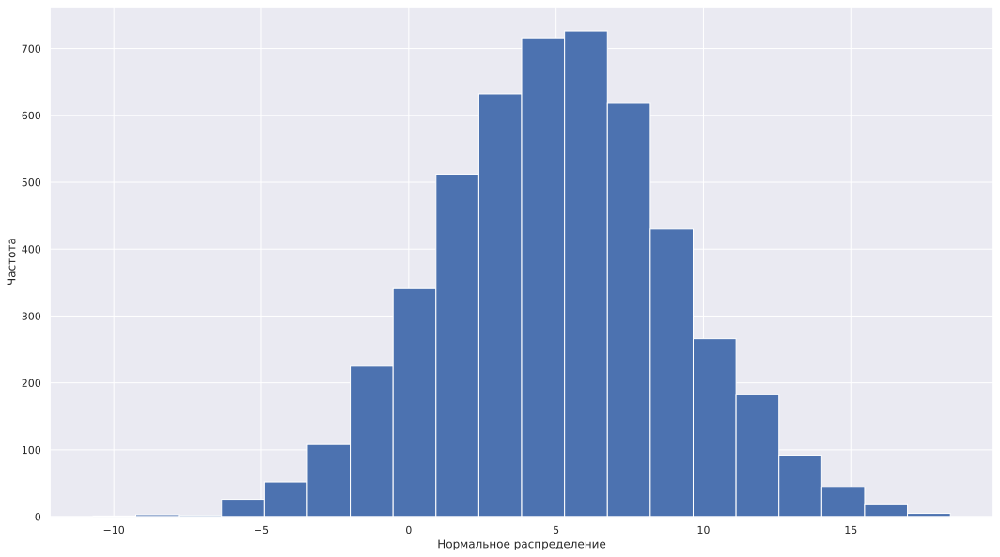

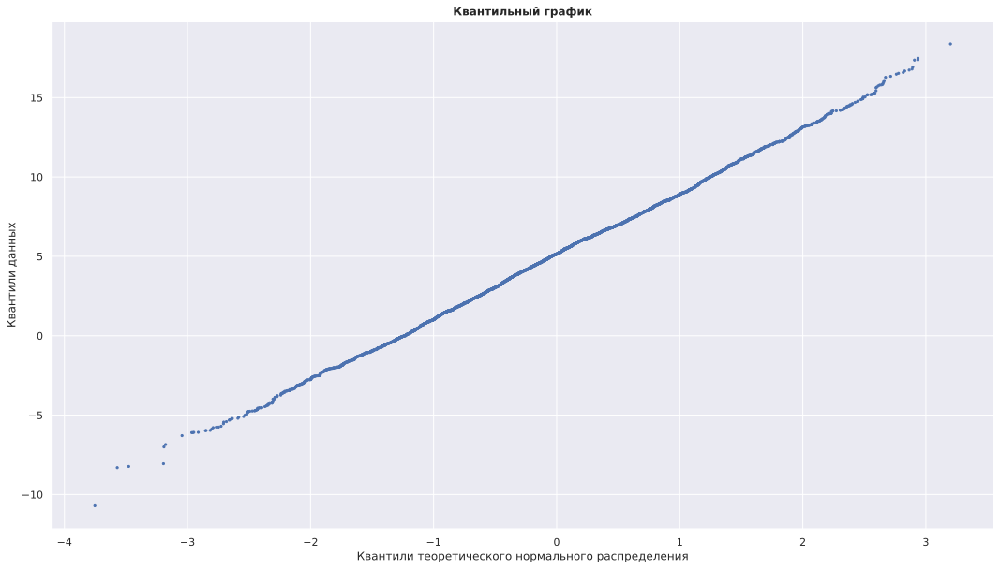

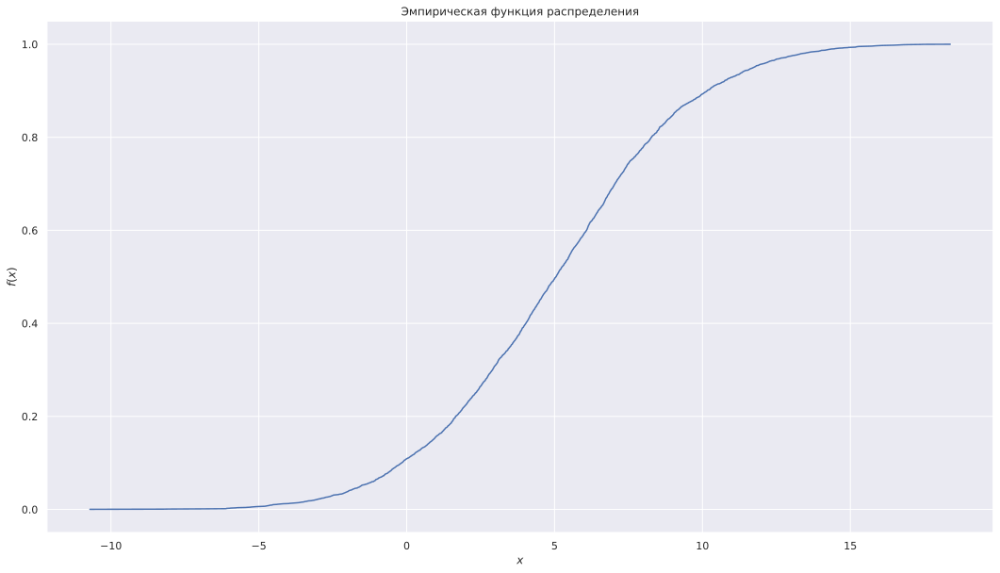

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.755648735349848, pvalue=0.0)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9995850920677185, pvalue=0.3793225884437561)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.5111647526673551, critical_values=array([0.576, 0.655, 0.786, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=1050.6549029810644, pvalue=2.455835859116462e-07)
Тест Лиллиефорса:
	 (0.011653602683604936, 0.10034795436622418)


In [ ]:
ex_5(0, 1, 100)
ex_5(0, 1, 1000)
ex_5(0, 1, 5000)
ex_5(5, 4, 100)
ex_5(5, 4, 1000)
ex_5(5, 4, 5000)

# 6. Продемонстрировать пример анализа данных с помощью графиков квантилей, метода огибающих, а также стандартных процедур проверки гипотез о нормальности. Рассмотреть выборки малого и умеренного объемов.

In [ ]:
def ex_6(xs):
    print("Распределение веса")
    quantile_plot(xs)
    empiric_plot(xs)
    print('Критерий Колмогорова-Смирнова:\n\t', stats.kstest(xs, 'norm'))
    print('Тест Шапира-Уилка:\n\t', stats.shapiro(xs))
    print('Тест Андерсона-Дарлинга:\n\t', stats.anderson(xs))
    print('Тест Крамера фон Мизеса:\n\t', stats.cramervonmises(xs, 'norm')) 
    print('Тест Лиллиефорса:\n\t' ,  lilliefors(xs, 'norm'))
    print('\n\n')

Распределение веса


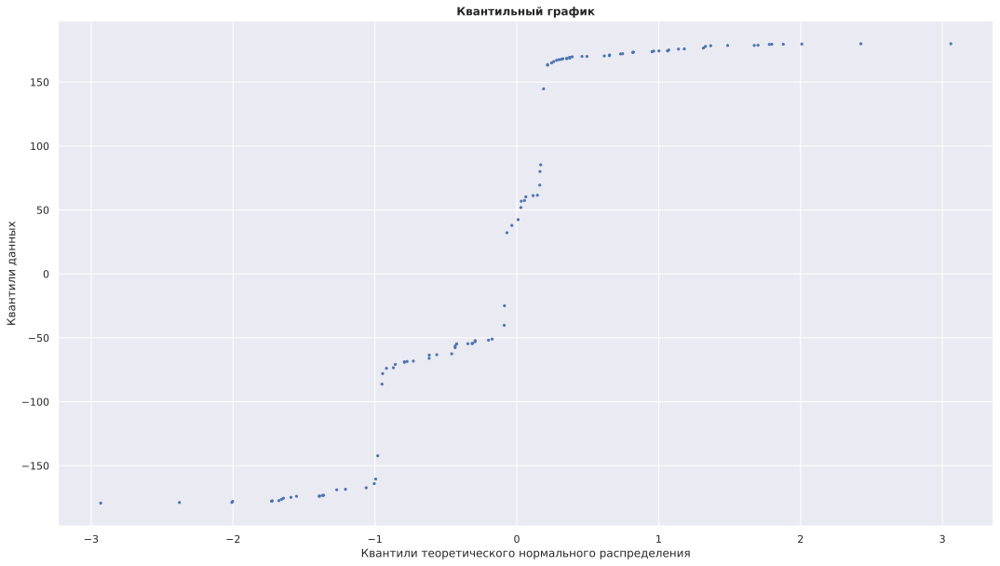

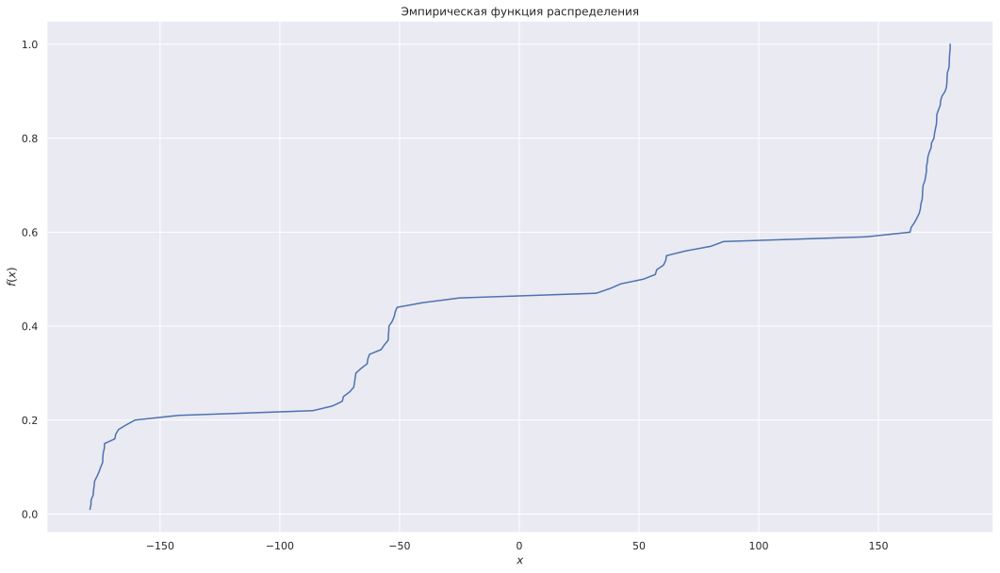

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=0.54, pvalue=8.032546727914933e-28)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.8267519474029541, pvalue=1.7947812125385099e-09)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=6.50378346286746, critical_values=array([0.555, 0.632, 0.759, 0.885, 1.053]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=8.493333333333334, pvalue=8.462974765421905e-11)
Тест Лиллиефорса:
	 (0.24359145598414023, 0.0009999999999998899)



Распределение веса


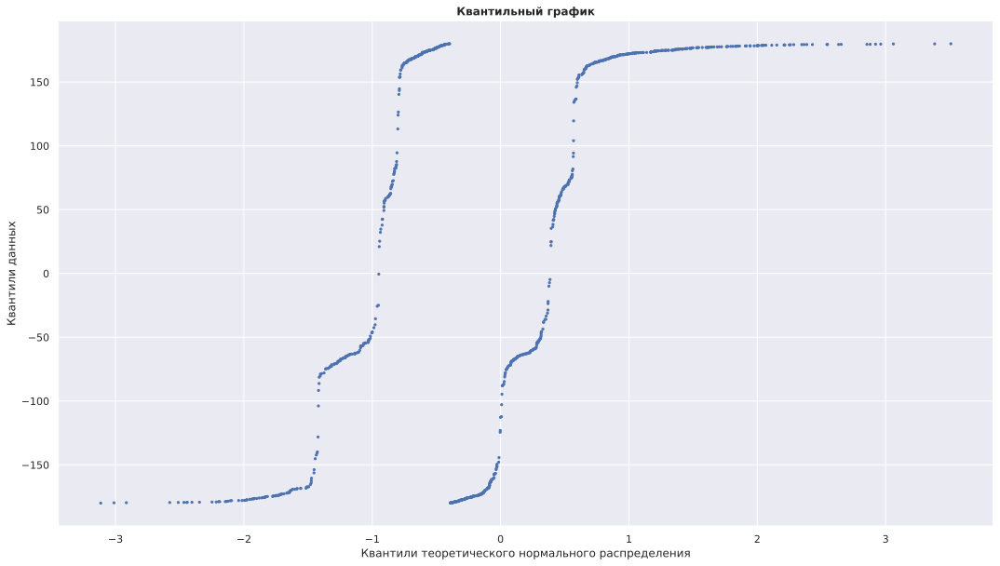

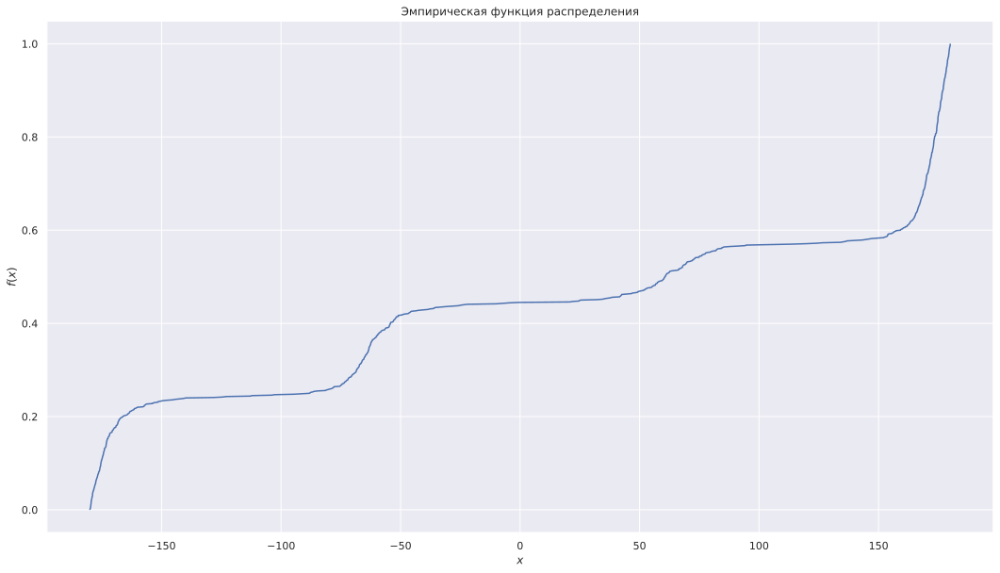

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=nan, pvalue=nan)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=nan, pvalue=1.0)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=nan, critical_values=array([0.574, 0.653, 0.784, 0.914, 1.088]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=nan, pvalue=1.0)
Тест Лиллиефорса:
	 (nan, nan)



Распределение веса


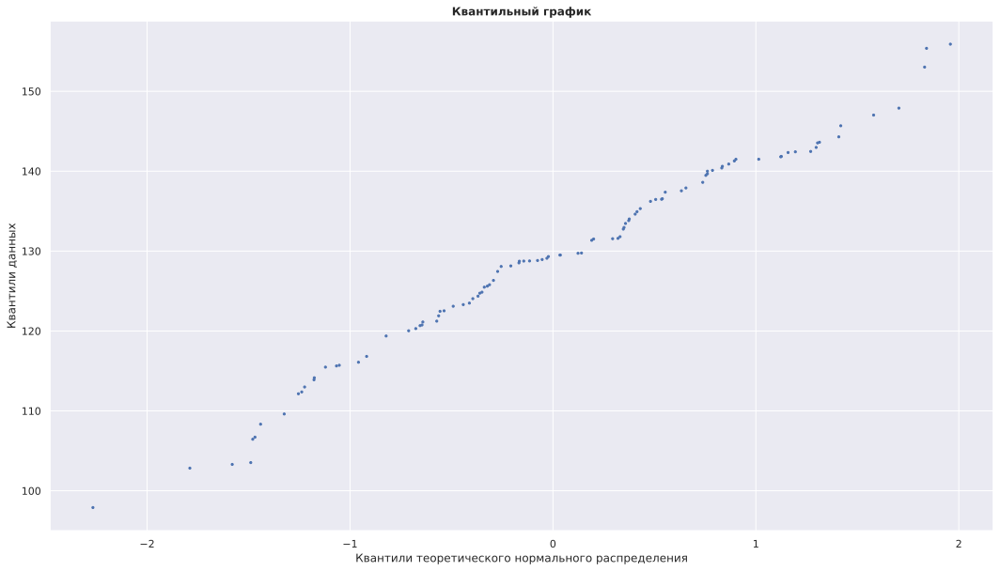

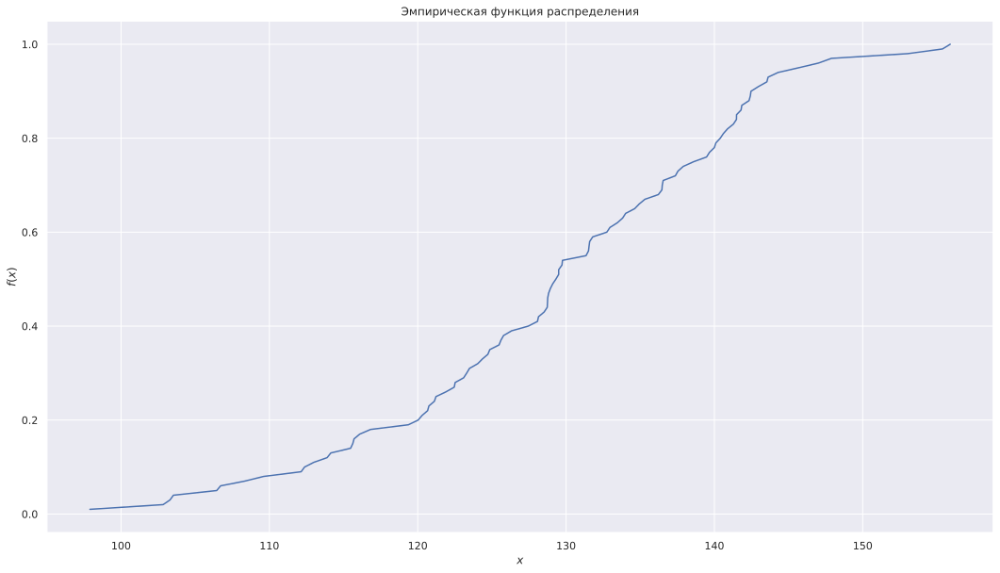

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=1.0, pvalue=0.0)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9849482774734497, pvalue=0.31487464904785156)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.45702280498990433, critical_values=array([0.555, 0.632, 0.759, 0.885, 1.053]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=33.33333333333333, pvalue=4.071928128013269e-09)
Тест Лиллиефорса:
	 (0.06269956891310474, 0.4388562994799908)



Распределение веса


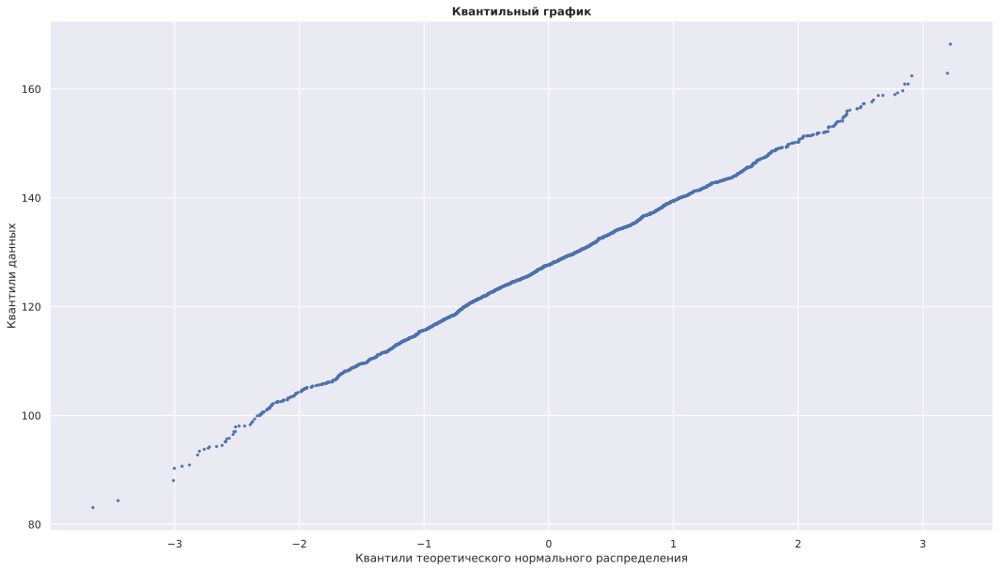

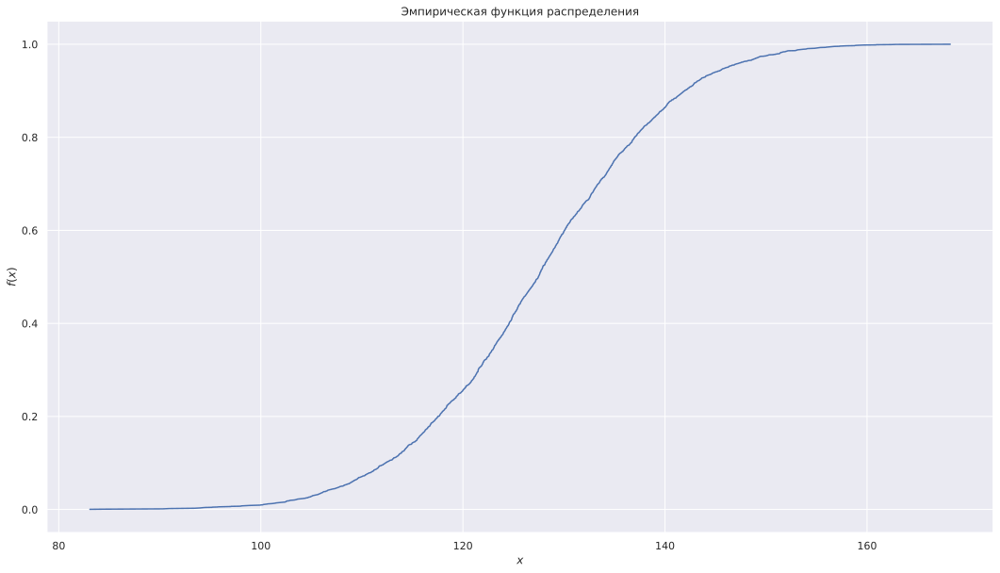

Критерий Колмогорова-Смирнова:
	 KstestResult(statistic=1.0, pvalue=0.0)
Тест Шапира-Уилка:
	 ShapiroResult(statistic=0.9994381070137024, pvalue=0.5392155647277832)
Тест Андерсона-Дарлинга:
	 AndersonResult(statistic=0.3654298367669071, critical_values=array([0.575, 0.655, 0.786, 0.917, 1.091]), significance_level=array([15. , 10. ,  5. ,  2.5,  1. ]))
Тест Крамера фон Мизеса:
	 CramerVonMisesResult(statistic=999.9999999999999, pvalue=2.557981104711615e-07)
Тест Лиллиефорса:
	 (0.014374908563957012, 0.15532014095615118)





In [ ]:
ex_6(protein['chi_1'][0:100])
ex_6(protein['chi_1'][0:1000])
ex_6(weight[0:100])
ex_6(weight[0:3000])

# 7. Продемонстрировать применение для проверки различных гипотез и различных доверительных уровней (0.9, 0.95, 0.99) следующих критериев:
a. Стьюдента, включая односторонние варианты, когда проверяемая нулевая гипотеза заключается в том, что одно из сравниваемых средних значений больше (или меньше) другого. Реализовать оценку мощности критериев при заданном объеме выборки или определения объема выборки для достижения заданной мощности;
b. Уилкоксона-Манна-Уитни (ранговые);
c. Фишера, Левене, Бартлетта, Флигнера-Килина (проверка
гипотез об однородности дисперсий).


In [ ]:
from scipy.stats import mannwhitneyu
import statsmodels.stats.power as pw

In [ ]:
def ex_7(sample_1, sample_2):
    sample_loc = sample_1.mean()
    sample_scale = sample_2.std()
    ci_90 = stats.t.interval(0.90, df=len(sample_1)-1, loc=sample_loc, scale=sample_scale)
    ci_95 = stats.t.interval(0.95, df=len(sample_1)-1, loc=sample_loc, scale=sample_scale)
    ci_99 = stats.t.interval(0.99, df=len(sample_1)-1, loc=sample_loc, scale=sample_scale)
    print("a) Доверительный интервал стьюдента:\n\t90% - {0},\n\t95% - {1},\n\t99% - {2}".format(ci_90, ci_95, ci_99))
    
    stat, p = stats.ttest_ind(sample_1, sample_2, equal_var=False, alternative = 'less')
    print('   Односторонний(меньше) критерий Стьюдента:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    stat, p = stats.ttest_ind(sample_1, sample_2, equal_var=False, alternative = 'two-sided')
    print('   Двусторонний критерий Стьюдента:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    effect_size = 0.8
    alpha = 0.05
    power = float(input("   Определение объема выборки для достижения заданной мощности. Введите желаемую мощность критерия:"))
    power_analysis = pw.TTestIndPower()
    sample_size = power_analysis.solve_power(effect_size=effect_size, power=power, alpha=alpha)
    print("\tТребуемый размер выборки: %d" %(sample_size))
    
   
    stat, p = mannwhitneyu(sample_1, sample_2)
    print('b) Уилкоксона-Манна-Уитни (ранговые):\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    f = np.var(sample_1, ddof=1)/np.var(sample_2, ddof=1)
    x = np.array(sample_1)
    y = np.array(sample_2)
    nun = x.size-1
    dun = y.size-1
    p_value = 1-stats.f.cdf(f, nun, dun)
    
    print('c) Тест Фишера:\n\tStatistics=%.3f, p=%.3f' % (f, p_value))
    alpha = 0.05
    if p_value > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    p_value = stats.levene(sample_1, sample_2, center = 'mean')
    print('   Тест Левене:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    stat, p = stats.bartlett(sample_1, sample_2)
    print('   Тест Бартлета:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    stat, p = stats.fligner(sample_1, sample_2, center = 'mean')
    print('   Тест Флигнера-Килина:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')

In [ ]:

ex_7(weight, height)

a) Доверительный интервал стьюдента:
	90% - (123.95132201895, 130.20752030265),
	95% - (123.35201879135175, 130.80682353024827),
	99% - (122.18064722637875, 131.97819509522128)
   Односторонний(меньше) критерий Стьюдента:
	Statistics=790.724, p=1.000
	Same distribution (fail to reject H0)
   Двусторонний критерий Стьюдента:
	Statistics=790.724, p=0.000
	Different distribution (reject H0)
   Определение объема выборки для достижения заданной мощности. Введите желаемую мощность критерия:0.8
	Требуемый размер выборки: 25
b) Уилкоксона-Манна-Уитни (ранговые):
	Statistics=625000000.000, p=0.000
	Different distribution (reject H0)
c) Тест Фишера:
	Statistics=37.600, p=0.000
	Different distribution (reject H0)
   Тест Левене:
	Statistics=625000000.000, p=0.000
	Different distribution (reject H0)
   Тест Бартлета:
	Statistics=57326.812, p=0.000
	Different distribution (reject H0)
   Тест Флигнера-Килина:
	Statistics=21701.308, p=0.000
	Different distribution (reject H0)


In [ ]:
ex_7(protein[0:500]['gamma1'], protein[0:500]['gamma2'])

a) Доверительный интервал стьюдента:
	90% - (38.578287113208376, 144.70079038358452),
	95% - (28.37709612025516, 154.90198137653778),
	99% - (8.381855868119615, 174.89722162867332)
   Односторонний(меньше) критерий Стьюдента:
	Statistics=-0.416, p=0.339
	Same distribution (fail to reject H0)
   Двусторонний критерий Стьюдента:
	Statistics=-0.416, p=0.677
	Same distribution (fail to reject H0)
   Определение объема выборки для достижения заданной мощности. Введите желаемую мощность критерия:0.8
	Требуемый размер выборки: 25
b) Уилкоксона-Манна-Уитни (ранговые):
	Statistics=121745.000, p=0.459
	Same distribution (fail to reject H0)
c) Тест Фишера:
	Statistics=0.878, p=0.927
	Same distribution (fail to reject H0)
   Тест Левене:
	Statistics=121745.000, p=0.459
	Same distribution (fail to reject H0)
   Тест Бартлета:
	Statistics=2.123, p=0.145
	Same distribution (fail to reject H0)
   Тест Флигнера-Килина:
	Statistics=33.634, p=0.000
	Different distribution (reject H0)


# 8. Исследование корреляционных взаимосвязей в данных с помощью коэффициентов корреляции Пирсона, Спирмена и Кендалла.


In [ ]:
def ex_8(sample):
    print("Расчет коэффициента корреляции Пирсона:")
    print(sample.corr()) # Расчет коэффициента корреляции Пирсона
    print("Расчет коэффициента корреляции Спирмена:")
    print(sample.corr('spearman')) # Вычислить коэффициент корреляции spearman
    print("Расчет коэффициента корреляции Кендала:")
    print(sample.corr('kendall')) # Расчет коэффициента корреляции Кендалла
ex_8(protein[['phi', 'psi', 'tau']])

Расчет коэффициента корреляции Пирсона:
          phi       psi       tau
phi  1.000000 -0.573042 -0.749729
psi -0.573042  1.000000  0.803593
tau -0.749729  0.803593  1.000000
Расчет коэффициента корреляции Спирмена:
          phi       psi       tau
phi  1.000000 -0.616553 -0.811322
psi -0.616553  1.000000  0.810422
tau -0.811322  0.810422  1.000000
Расчет коэффициента корреляции Кендала:
          phi       psi       tau
phi  1.000000 -0.443558 -0.610972
psi -0.443558  1.000000  0.611138
tau -0.610972  0.611138  1.000000


# 9. Использование методов хи-квадрат, точного теста Фишера, теста МакНемара, Кохрана-Мантеля-Хензеля

In [ ]:
pip install cmh

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from statsmodels.stats.contingency_tables import mcnemar
from cmh import CMH

Анализируем распределение полов по форме речи(диалект ли)
vote_table - сводная таблицы пол/форма

In [ ]:
language = pd.read_csv("https://raw.githubusercontent.com/agricolamz/DS_for_DH/master/data/dialect_forms_fake.csv")


In [ ]:
vote_table =  pd.crosstab(language['form'], language['gender'])

In [ ]:
vote_table

gender,female,male
form,,
dialect,107,74
standard,93,45


In [ ]:
def ex_8(sample, toy):
    from scipy.stats import chi2_contingency
    stat, p, dof, expected = chi2_contingency(sample)
    print('Метод хи-квадрат:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame distribution (fail to reject H0)')
    else:
        print('\tDifferent distribution (reject H0)')
        
    stat, p = stats.fisher_exact(sample)
    print('Точный метод Фишера:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tНет различий в разногласиях (fail to reject H0)')
    else:
        print('\tЗначительная разница в разногласиях (reject H0)')
    
    
    result = mcnemar(sample, exact=True)
    print('Тест МакНемара:\n\tstatistic=%.3f, p-value=%.3f' % (result.statistic, result.pvalue))
    alpha = 0.05
    if result.pvalue > alpha:
        print('\tSame proportions of errors (fail to reject H0)')
    else:
        print('\tDifferent proportions of errors (reject H0)')
    
    result = CMH(toy, 'Gender', 'Age',stratifier='Illness')
    print(result)

In [ ]:
ex_8(vote_table, toy)

Метод хи-квадрат:
	Statistics=1.952, p=0.162
	Same distribution (fail to reject H0)
Точный метод Фишера:
	Statistics=0.700, p=0.161
	Нет различий в разногласиях (fail to reject H0)
Тест МакНемара:
	statistic=0.000, p-value=0.000
	Different proportions of errors (reject H0)

        Cochran-Mantel-Haenszel Chi2 test

"Gender" x "Age", stratified by "Illness"

Cochran-Mantel-Haenszel M^2 = 50.25967, dof = 40, p-value = 0.1283



# 10. Наличие мультиколлинеарности в данных с помощью корреляционной матрицы и фактора инфляции дисперсии.

Корреляционную матрицу строили в 7 пункте. Здесь сделаем тепловую карту и сделаем вывод, какой атрибут имеет наиболее значимое значение корреляции. 

In [ ]:
from statsmodels.regression.linear_model import OLS
from statsmodels.tools.tools import add_constant
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

def ex_10(sample):
    print("Mультиколлинеарность в данных с помощью корреляционной матрицы:")
    print(sample.corr())  
    sample_plot = sns.heatmap(sample.corr(), cmap="YlGnBu", annot=True)  
    plt.show()
    print("Mультиколлинеарность в данных с помощью фактора инфляции дисперсии:")
    sample_constant = sm.add_constant(sample)

    vif = [variance_inflation_factor(sample_constant.values, i) for i in range(sample_constant.shape[1])]
    print(pd.DataFrame({'vif': vif[1:]}, index=sample.columns).T)

Mультиколлинеарность в данных с помощью корреляционной матрицы:
          phi       psi       tau
phi  1.000000 -0.573042 -0.749729
psi -0.573042  1.000000  0.803593
tau -0.749729  0.803593  1.000000


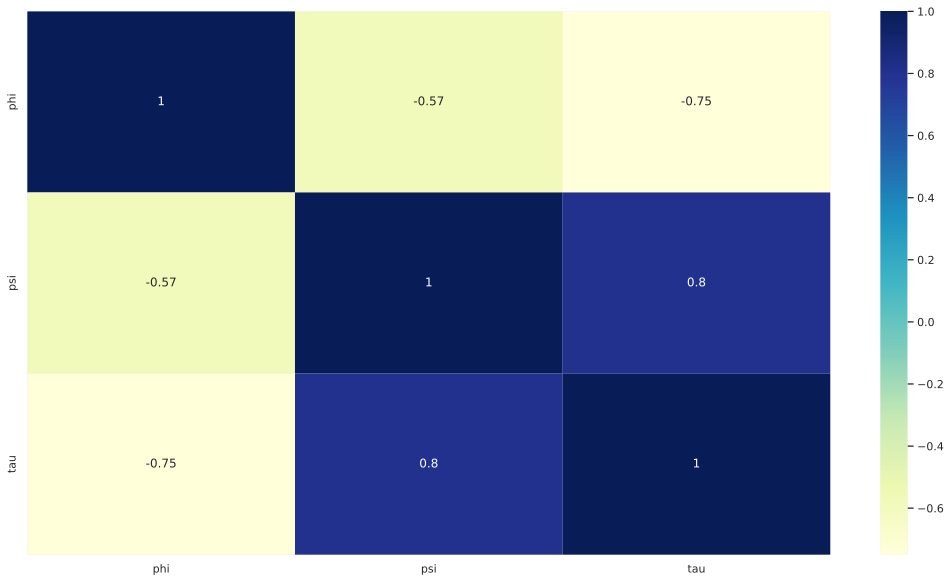

Mультиколлинеарность в данных с помощью фактора инфляции дисперсии:
          phi       psi       tau
vif  2.296422  2.838817  4.353938


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/tsatools.py:142: FutureWarning: In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only
  x = pd.concat(x[::order], 1)


In [ ]:
df = protein[["phi", "psi", "tau"]] 
ex_10(df)

# 11. Исследовать зависимости в данных с помощью дисперсионного анализа.

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt 
import statsmodels.api as sm 
from statsmodels.formula.api import ols 
import seaborn as sns 
import numpy as np 
import pandas.tseries 
import scipy.stats as stats
from scipy.stats import f_oneway

In [ ]:
toy_dallas = toy[toy['City'] == "Dallas"]['Income']
toy_washington = toy[toy['City'] == "Washington D.C."]['Income']
toy_austin = toy[toy['City'] == "Austin"]['Income']

In [ ]:
def ex_11(group1, group2, group3):
    stat, p = f_oneway(group1, group2, group3)
    print('Однофакторный дисперсионный анализ:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    alpha = 0.05
    if p > alpha:
        print('\tSame mean (fail to reject H0)')
    else:
        print('\tDifferent mean (reject H0)')
    
    print('Дисперсионный по Краскелу-Уоллису:\n\tStatistics=%.3f, p=%.3f' % (stat, p))
    
    '''
    Kruskal-Wallis test не предполагает ни нормальности популяции, 
    ни однородности дисперсии, как и параметрическая ANOVA, 
    и требует только упорядоченного масштабирования зависимой переменной. 
    Kruskal-Wallis используется, когда нарушения нормальности популяции 
    и/или однородности дисперсии являются экстремальными
    '''
    stat, p = stats.kruskal(group1, group2, group3)
    alpha = 0.05
    if p > alpha:
        print('\tРаспределение одинаковое (не отклоняем H0)')
    else:
        print('\tРаспределение разное (отклоняем H0)')

In [ ]:
ex_11(toy_dallas, toy_washington, toy_austin)

Однофакторный дисперсионный анализ:
	Statistics=63631.429, p=0.000
	Different mean (reject H0)
Дисперсионный по Краскелу-Уоллису:
	Statistics=63631.429, p=0.000
	Распределение разное (отклоняем H0)


# 12. Подогнать регрессионные модели (в том числе, нелинейные) к данным, а также оценить качество подобной аппроксимации.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, median_absolute_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
toy = pd.read_csv('toy_dataset.csv')

In [ ]:
def ex_12_1(X, y, fn, cn):
    X_train, X_test, y_train, y_test = train_test_split(X, y,test_size = 0.3, random_state=42)
    clf = DecisionTreeClassifier(max_depth = 4, random_state = 0)
    clf.fit(X_train, y_train)
    tree.plot_tree(clf)
    clf.predict(X_test)
    tree.plot_tree(clf)


    fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (30,10), dpi=600)
    
    tree.plot_tree(clf,
                   feature_names=fn, 
                   class_names=cn,
                   fontsize=5,
                   filled = True);
    fig.savefig('imagename.png')

    print("R^2: {0}".format(r2_score(y_test, clf.predict(X_test))))

In [ ]:
from sklearn.preprocessing import LabelEncoder
citys = toy.City.unique()
le = LabelEncoder()
le.fit(toy['City'])
toy["City"] = le.transform(toy["City"])

R^2: -0.5023717346970653


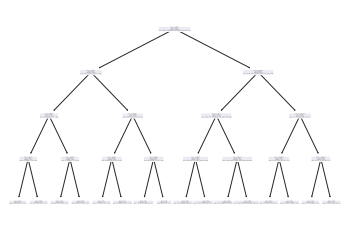

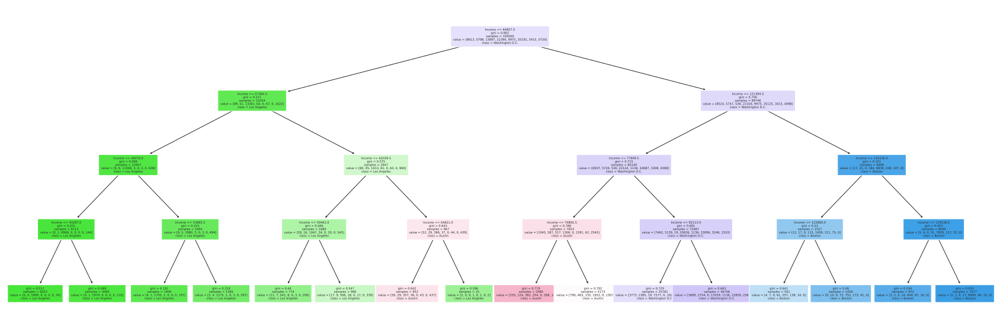

In [ ]:
ex_12_1(toy[['Age', 'Income']], toy[['City']], ['Age','Income'], citys)

От возраста не зависит - дерево строится по доходу

In [ ]:
def ex_12_2(X, y):
    regr = LinearRegression()
    quad = PolynomialFeatures(degree=2)
    cub = PolynomialFeatures(degree=3)
    
    X_quad = quad.fit_transform(X)
    X_cub = cub.fit_transform(X)

    X_fit = np.arange(X.min(), X.max(), 1)[:, np.newaxis]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
    X_quad_train = quad.fit_transform(X_train)
    X_quad_test = quad.fit_transform(X_test)
    X_cub_train = cub.fit_transform(X_train)
    X_cub_test = cub.fit_transform(X_test)
    regr = regr.fit(X, y)
    y_lin_fit = regr.predict(X_fit)
    linear_train_r2 = r2_score(y_train, regr.predict(X_train))
    linear_test_r2 = r2_score(y_test, regr.predict(X_test))

    regr = regr.fit(X_quad, y)
    y_quad_fit = regr.predict(quad.fit_transform(X_fit))
    quad_train_r2 = r2_score(y_train, regr.predict(X_quad_train))
    quad_test_r2 = r2_score(y_test, regr.predict(X_quad_test))

    regr = regr.fit(X_cub, y)
    y_cub_fit = regr.predict(cub.fit_transform(X_fit))
    cub_train_r2 = r2_score(y_train, regr.predict(X_cub_train))
    cub_test_r2 = r2_score(y_test, regr.predict(X_cub_test))
    


    plt.scatter(X, y, label='training points', color='lightgray')

    plt.plot(X_fit, y_lin_fit, 
            label='linear (d=1), $R^2: train={:.2f}, test={:.2f}$'.format(linear_train_r2, linear_test_r2), 
             color='blue', 
             lw=2, 
             linestyle=':')

    plt.plot(X_fit, y_quad_fit, 
             label='quadratic (d=2), $R^2: train={:.2f}, test={:.2f}$'.format(quad_train_r2, quad_test_r2),
             color='red', 
             lw=2,
             linestyle='-')

    plt.plot(X_fit, y_cub_fit, 
             label='cubic (d=3), $R^2: train={:.2f}, test={:.2f}$'.format(cub_train_r2, cub_test_r2),
             color='green', 
             lw=2, 
             linestyle='--')

    plt.xlabel('psi')
    plt.ylabel('tau')
    plt.legend(loc='upper right')

График линейной, квадратичной, кубической линейных регрессий для углов psi и tau, для которых коэффициент корреляции большой - 0.82

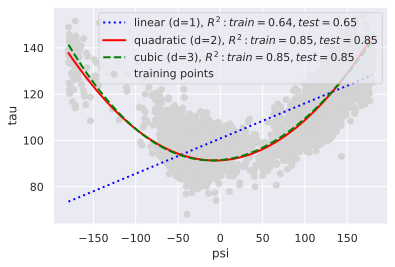

In [ ]:
ex_12_2(protein[['psi']].values, protein['tau'].values)

In [ ]:
%%shell 
jupyter nbconvert --to html /content/Practicum_python_5_semestr-2.ipynb

[NbConvertApp] WARNING | pattern '/content/Practicum_python_5_semestr-2.ipynb' matched no files
This application is used to convert notebook files (*.ipynb)
        to various other formats.


Options
The options below are convenience aliases to configurable class-options,
as listed in the "Equivalent to" description-line of the aliases.
To see all configurable class-options for some <cmd>, use:
    <cmd> --help-all

--debug
    set log level to logging.DEBUG (maximize logging output)
    Equivalent to: [--Application.log_level=10]
--show-config
    Show the application's configuration (human-readable format)
    Equivalent to: [--Application.show_config=True]
--show-config-json
    Show the application's configuration (json format)
    Equivalent to: [--Application.show_config_json=True]
--generate-config
    generate default config file
    Equivalent to: [--JupyterApp.generate_config=True]
-y
    Answer yes to any questions instead of prompting.
    Equivalent to: [--JupyterApp.answ

CalledProcessError: ignored